In [1]:
import pandas as pd
import geopandas as gpd
import folium
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
from IPython.display import Markdown as md, HTML

from nycschools import schools, ui, geo
from nycschools.dataloader import load
import warnings
warnings.filterwarnings('ignore')

In [2]:
df = load("census.geojson")

districts = geo.load_districts()

race_cols = [ "asian", "black", "indian", "latino", "mixed", "other", "pacific", "white" ]

# just the most recent year
data = df[df.year == df.year.max()].copy()


In [3]:

# create a new column for the total population in each tract by summing the values in race_cols
data["pop"] = data.asian + data.black + data.indian + data.latino + data.mixed + data.other + data.pacific + data.white
print(f"""Total population NYC: {data["pop"].sum():,}""")
tracts = data[data["pop"] > 0]
tracts["pop"].describe()

Total population NYC: 8,622,467


count     2242.000000
mean      3845.881802
std       1967.840256
min          3.000000
25%       2447.250000
50%       3529.000000
75%       4925.250000
max      15945.000000
Name: pop, dtype: float64

In [6]:
# generate random, colored point locations for every 10 people in school district 13 and bordering areas
colors = {
    "mixed": "blue",
    "other": "grey",
    "pacific": "green",
    "white": "cyan",
    "black": "orange",
    "indian": "pink",
    "latino": "purple",
    "asian": "red",
}
tracts

,geoid,name,median_inc,total_pop,asian,black,indian,latino,mixed,other,pacific,white,state,county,tract,year,geometry,pop
24,36061000201,Census Tract 2.01; New York County; New York,45582.0,2666,400,216,0,1747,65,0,0,238,36,061,000201,2022,"POLYGON ((-73.98450 40.70952, -73.98655 40.709...",2666
37,36061000600,Census Tract 6; New York County; New York,25655.0,10751,5567,654,0,3301,147,223,0,859,36,061,000600,2022,"POLYGON ((-73.99022 40.71441, -73.98934 40.714...",10751
50,36061001401,Census Tract 14.01; New York County; New York,89873.0,3165,251,85,0,314,219,48,24,2224,36,061,001401,2022,"POLYGON ((-73.98837 40.71645, -73.98754 40.716...",3165
63,36061001402,Census Tract 14.02; New York County; New York,46615.0,3286,1099,250,0,860,196,0,0,881,36,061,001402,2022,"POLYGON ((-73.98507 40.71909, -73.98423 40.718...",3286
76,36061001800,Census Tract 18; New York County; New York,74485.0,6948,3148,405,13,1057,104,84,0,2137,36,061,001800,2022,"POLYGON ((-73.98986 40.72053, -73.98972 40.720...",6948
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27271,36005033400,Census Tract 334; Bronx County; New York,-666666666.0,38,0,35,0,2,0,0,0,1,36,005,033400,2022,"POLYGON ((-73.86944 40.87814, -73.86936 40.878...",38
27274,36085022602,Census Tract 226.02; Richmond County; New York,-666666666.0,1471,0,10,55,127,0,0,0,1279,36,085,022602,2022,"POLYGON ((-74.20700 40.55758, -74.20880 40.557...",1471
27287,36085024800,Census Tract 248; Richmond County; New York,131146.0,5058,127,8,0,817,0,0,14,4092,36,085,024800,2022,"POLYGON ((-74.22948 40.51909, -74.22963 40.519...",5058
27300,36081003400,Census Tract 34; Queens County; New York,79728.0,2559,468,86,7,1628,4,108,0,258,36,081,003400,2022,"POLYGON ((-73.85053 40.68760, -73.84999 40.686...",2559


In [18]:


def make_rand_points(row):
    scale = 100
    results = []
    for group, color in colors.items():
        num_points = row[group] // scale
        if num_points > 0:
            points = ui.rand_points(row.geometry, num_points)
            points["group"] = group
            points["color"] = color
            results.append(points)
    return pd.concat(results) if results else pd.DataFrame()



points = tracts.apply(make_rand_points, axis=1).tolist()
points = pd.concat(points)
points

,geometry,group,color
0,POINT (-73.98644325143555 40.7118889469575),white,cyan
1,POINT (-73.98532724460988 40.709828232209404),white,cyan
0,POINT (-73.98499987968354 40.70950032006622),black,orange
1,POINT (-73.98606880362016 40.71031326976344),black,orange
0,POINT (-73.98594442414479 40.71054698746928),latino,purple
...,...,...,...
5,POINT (-73.86665395945464 40.68112705559688),asian,red
6,POINT (-73.86651246469225 40.68283821925208),asian,red
7,POINT (-73.86631387088369 40.68194689229965),asian,red
8,POINT (-73.86402714555341 40.6815141727659),asian,red


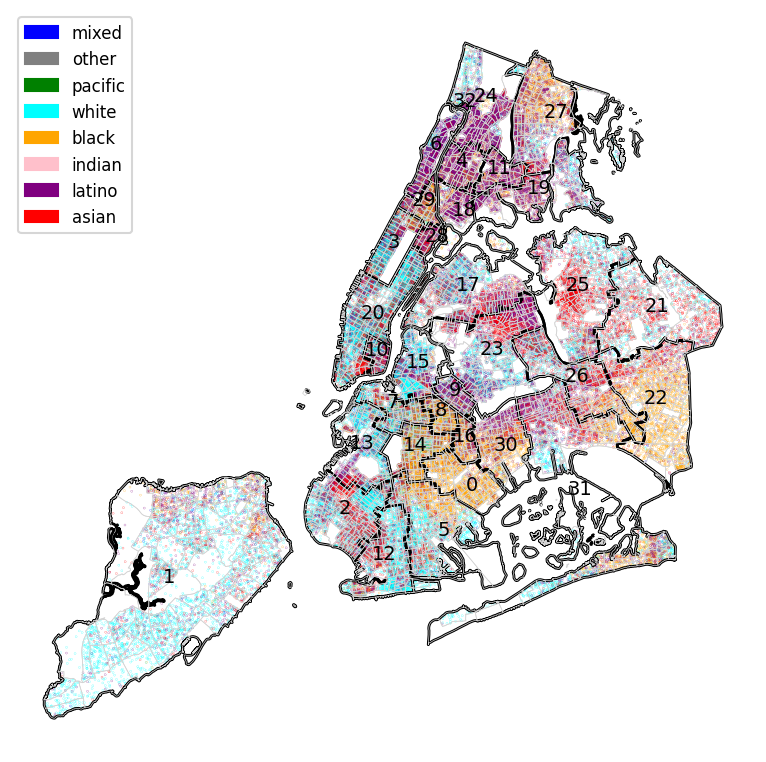

In [22]:
points = gpd.GeoDataFrame(points, geometry='geometry', crs=tracts.crs)

fig_scale = .5
fig, ax = plt.subplots(1, 1, figsize=(16*fig_scale, 16*fig_scale))
sns.set_context('talk')
plt.axis('off')
fig.tight_layout()

# plot the points
_ = points.plot(ax=ax, color=points.color, facecolor=points.color, markersize=.02, alpha=1)

# plot school district boundaries
_ = districts.plot(ax=ax, facecolor="none", edgecolor='black', linewidth=2)

# annotate with district number
districts["xy"] = districts.geometry.centroid.apply(lambda x: x.coords[0])
_ = districts.apply(lambda row: ax.annotate( row.name, xy=row.xy, ha='center', fontsize=14), axis=1)

# plot census tracts in light gray
_ = data.plot(ax=ax, facecolor="none", edgecolor='lightgray', linewidth=0.5)
patches = [mpatches.Patch(color=color, label=label) for label, color in colors.items()]
_ = ax.legend(handles=patches, loc='upper left', fontsize=12)
fig.savefig("nyc-dots.png")

In [41]:

# recalculate the tracts to match the city's population
entropy = data.copy()
N = entropy["pop"].sum()
asian_pct = entropy["asian"].sum() / N
black_pct = entropy["black"].sum() / N
indian_pct = entropy["indian"].sum() / N
latino_pct = entropy["latino"].sum() / N
mixed_pct = entropy["mixed"].sum() / N
other_pct = entropy["other"].sum() / N
pacific_pct = entropy["pacific"].sum() / N
white_pct = entropy["white"].sum() / N

entropy["asian"] = (entropy["pop"] * asian_pct).astype(int)
entropy["black"] = (entropy["pop"] * black_pct).astype(int)
entropy["indian"] = (entropy["pop"] * indian_pct).astype(int)
entropy["latino"] = (entropy["pop"] * latino_pct).astype(int)
entropy["mixed"] = (entropy["pop"] * mixed_pct).astype(int)
entropy["other"] = (entropy["pop"] * other_pct).astype(int)
entropy["pacific"] = (entropy["pop"] * pacific_pct).astype(int)
entropy["white"] = (entropy["pop"] * white_pct).astype(int)

entropy["pop"].sum(), sum([entropy["asian"].sum(), entropy["black"].sum(), entropy["indian"].sum(), entropy["latino"].sum(), entropy["mixed"].sum(), entropy["other"].sum(), entropy["pacific"].sum(), entropy["white"].sum()])
entropy = entropy[entropy["pop"] > 0]


,geometry,group,color
0,POINT (-73.98496031219769 40.7112682435461),white,cyan
1,POINT (-73.98515000364156 40.71267429058364),white,cyan
2,POINT (-73.98622474876461 40.70972318933241),white,cyan
3,POINT (-73.98524075821646 40.711199361232985),white,cyan
4,POINT (-73.98677652896914 40.71289171899399),white,cyan
...,...,...,...
0,POINT (-73.94993229503268 40.78585646290369),asian,red
1,POINT (-73.95177311343615 40.78741211116155),asian,red
2,POINT (-73.95168076649612 40.78676756326722),asian,red
3,POINT (-73.95078403593425 40.78728345676734),asian,red


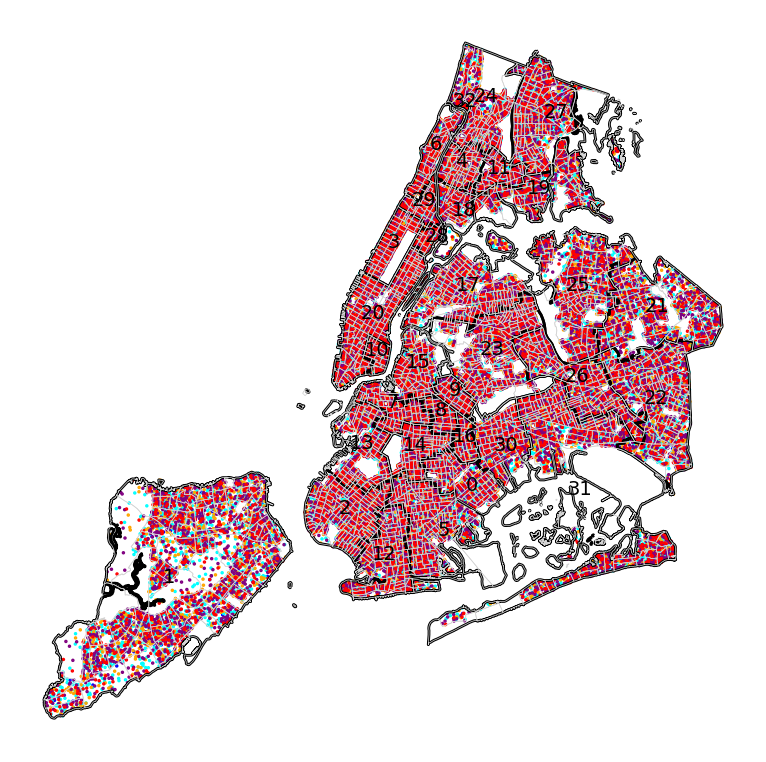

In [42]:

points = entropy.apply(make_rand_points, axis=1).tolist()
points = pd.concat(points)
points = gpd.GeoDataFrame(points, geometry='geometry', crs=data.crs)

fig, ax = plt.subplots(1, 1, figsize=(16*fig_scale, 16*fig_scale))
sns.set_context('talk')
plt.axis('off')
fig.tight_layout()

# plot the points
_ = points.plot(ax=ax, color=points.color, markersize=1)

# plot school district boundaries
_ = districts.plot(ax=ax, facecolor="none", edgecolor='black', linewidth=2)

# annotate with district number
districts["xy"] = districts.geometry.centroid.apply(lambda x: x.coords[0])
_ = districts.apply(lambda row: ax.annotate( row.name, xy=row.xy, ha='center', fontsize=14), axis=1)

# plot census tracts in light gray
_ = data.plot(ax=ax, facecolor="none", edgecolor='lightgray', linewidth=0.5)
fig.savefig("nyc-entropy-dots.png")

In [73]:
info = ["dbn", "school_name", "total_enrollment", "plurality", "black_pct", "hispanic_pct", "white_pct", "asian_pct", "poverty_pct"]
feet = feet[["dbn", "geometry"]].merge(d13[info + ["color"]], on="dbn", how="inner").reset_index(drop=True)
feet = feet.drop_duplicates(subset="dbn")

In [ ]:

feet["title"] = feet.apply(lambda x: f"{x['dbn']} ({x[x['plurality']+"_pct"]:.0%} {x['plurality'].title()})", axis=1)
feet["info"] = feet.apply(ui.popup(info), axis=1)
# map the school color onto the plurality
d13["color"] = d13.plurality.map(colors)
d13.plurality = d13.plurality.apply( lambda x: "Latinx" if x == "hispanic" else x.capitalize())
feet.plurality = feet.plurality.str.capitalize()


In [75]:

m = feet.explore(m=dot_map, color="color", tooltip="title", popup="info", style_kwds={"fillOpacity": 1, "opacity": 0})

m

In [12]:
m.save("d13-dot-density-demographics.html")